In [2]:
#Import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [3]:
#Import data for all countries
df= pd.read_csv('DIGITAL COMPETITIVENESS-clean.csv')
df.head()

,Country,Country Key,Year,Foreign highly skilled personnel,Digital/Technological skills,Total expenditure on R&D (%),Scientific research legislation,Mobile broadband subscribers,EParticipation,Use of big data and analytics,...,Government budget surplus/deficit (%),Tax evasion,Pension funding,Protectionism,Equal opportunity,Disposable income,Listed domestic companies,Image abroad or branding,Digital transformation in companies,Total final energy consumption per capita
0,Argentina,AR,1995,0.524565,0.708586,-0.561194,1.083241,1.023039,0.713693,1.130545,...,-0.836902,1.102487,1.127072,1.197865,1.255630,0.909835,-0.316336,0.095425,1.013746,-0.675466
1,Argentina,AR,1996,0.354150,0.238094,-0.541294,0.672756,1.443617,0.921162,0.866252,...,-0.303620,0.183795,0.647118,0.332324,0.558151,0.936739,-0.325779,-0.070533,0.329897,-0.659938
2,Argentina,AR,1997,0.148233,-0.076660,-0.541294,0.561211,1.245545,0.190871,0.933731,...,-0.482678,-0.823681,0.732945,1.159760,1.095966,0.464825,-0.377715,0.163510,0.505155,-0.597826
3,Argentina,AR,1998,-0.514489,-0.709447,-0.551244,0.070413,1.245545,0.190871,-0.069081,...,-0.521604,-1.202186,0.058750,0.299662,0.894285,0.440647,-0.406043,0.006063,-0.297251,-0.566770
4,Argentina,AR,1999,-0.563009,-0.114365,-0.511443,0.087145,1.245545,0.049793,0.084621,...,-0.397042,-1.118074,0.032775,0.555514,1.003529,0.937466,-0.410765,0.023084,-0.159794,-0.582298


In [4]:
#Split into numeric (df_num) and non-numeric (df_non) data
df_num=df.drop(['Country','Country Key','Year'], axis=1)
df_non=df[['Country','Country Key', 'Year']]

# EDA

CORRELATION HEATMAP

In [5]:
#Compute correlation matrix
corr=df_num.corr()

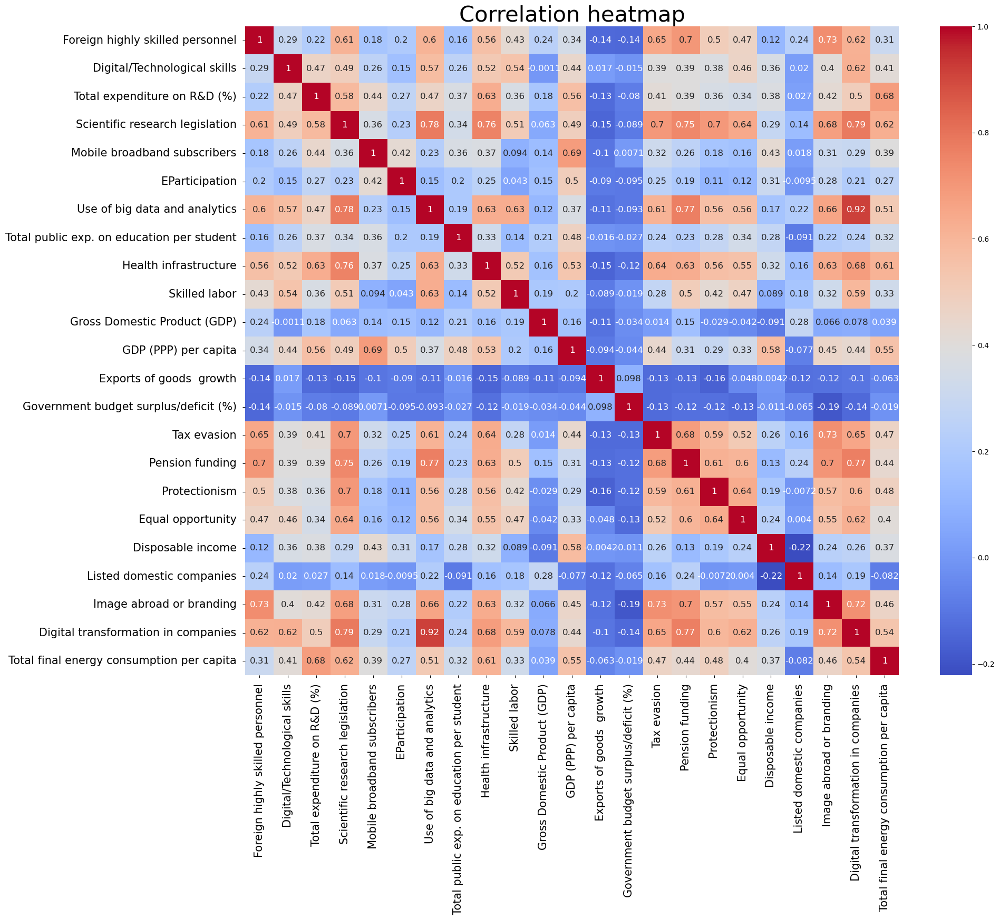

In [6]:
#Correlation heatmap
plt.figure(figsize=(20,16))
sns.heatmap(corr,annot=True, cmap='coolwarm', annot_kws={"size": 12})
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.title('Correlation heatmap', fontsize=30)
plt.show()

DISTRIBUTION PLOT

In [7]:
#Define number of rows and columns
num_plots=len(df_num.columns)
n_col=2
n_rows=int((num_plots/n_col)+0.5)
print("Number of plots:", num_plots,",Number of columns:", n_col,", Number of rows:",n_rows)

Number of plots: 23 ,Number of columns: 2 , Number of rows: 12


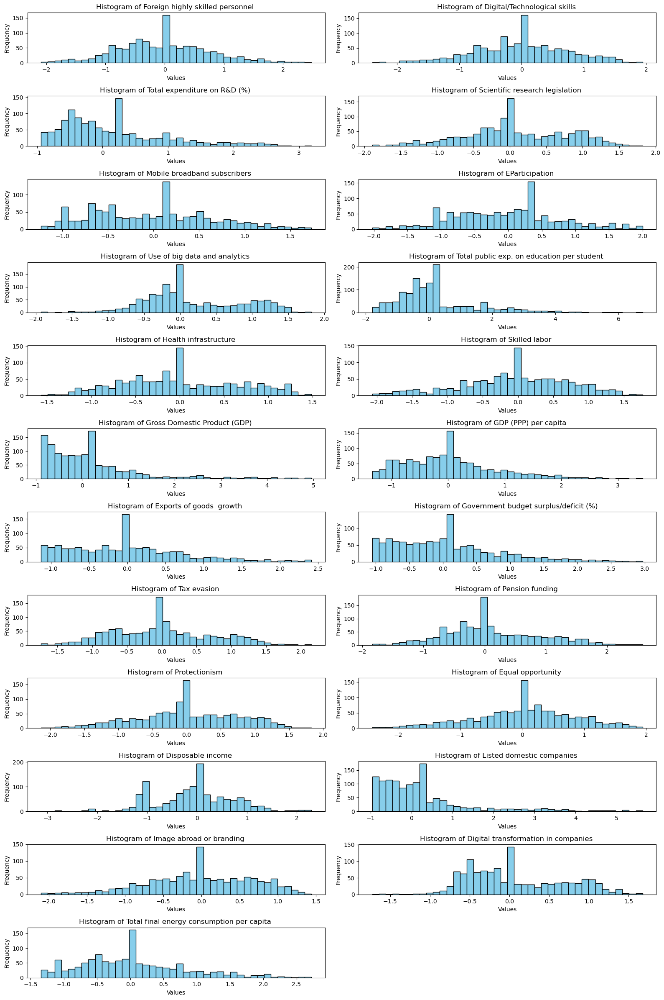

In [8]:
plt.figure(figsize=(16, 24))
  
# Loop through each column in the DataFrame and plot a histogram
for i, column in enumerate(df_num.columns):
    plt.subplot(len(df_num.columns)//2 + 1, 2, i+1)
    plt.hist(df_num[column], bins=40, color='skyblue', edgecolor='black')
    plt.title(f'Histogram of {column}')
    plt.xlabel('Values')
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

PAIR PLOTS

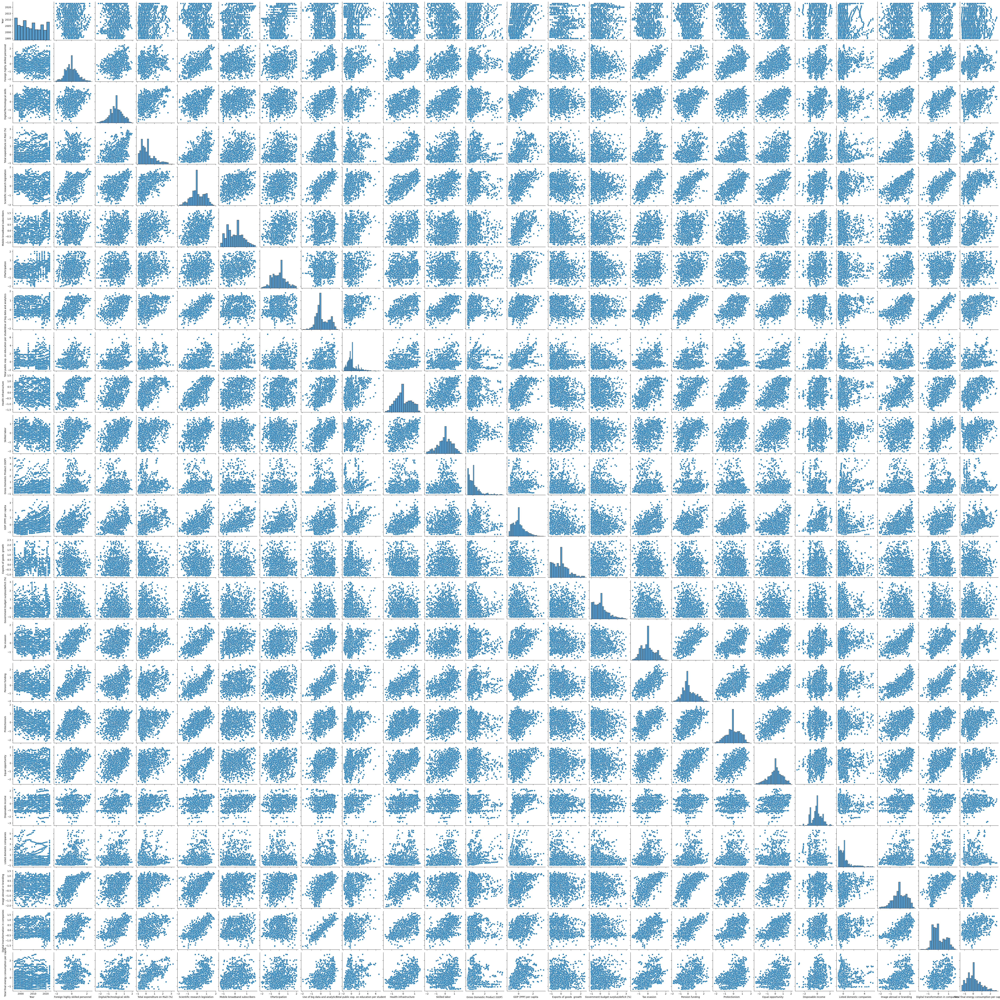

In [9]:
#Pair plots
sns.pairplot(df)
plt.show()

# DATA SPLIT

In [10]:
df_num.columns

Index(['Foreign highly skilled personnel ', 'Digital/Technological skills ',
       'Total expenditure on R&D (%) ', 'Scientific research legislation ',
       'Mobile broadband subscribers ', 'EParticipation ',
       'Use of big data and analytics ',
       'Total public exp. on education per student ', 'Health infrastructure ',
       'Skilled labor ', 'Gross Domestic Product (GDP) ',
       'GDP (PPP) per capita ', 'Exports of goods  growth ',
       'Government budget surplus/deficit (%) ', 'Tax evasion ',
       'Pension funding ', 'Protectionism ', 'Equal opportunity ',
       'Disposable income ', 'Listed domestic companies ',
       'Image abroad or branding ', 'Digital transformation in companies ',
       'Total final energy consumption per capita '],
      dtype='object')

In [11]:
#Split data
y=df_num['Digital/Technological skills '] #Target variable
X=df_num.drop(columns=['Digital/Technological skills '])

## PRINCIPAL COMPONENTS ANALYSIS (PCA)

In [12]:
#Fit PCA
pca=PCA()  #Number of principal components
pca.fit(X)
X_pca=pca.transform(X)

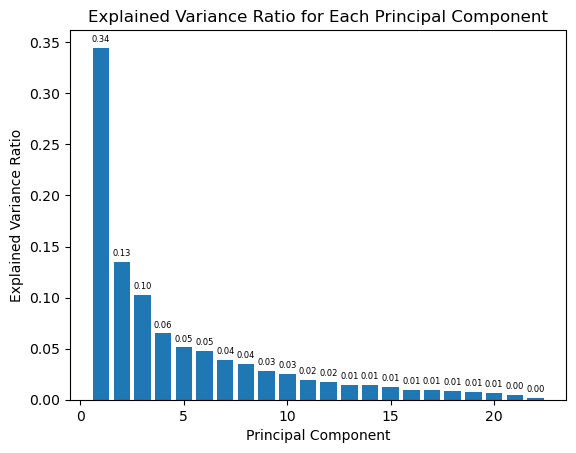

In [13]:
#Explained variance ratio
explained_variance_ratio=pca.explained_variance_ratio_

#Plot explained variance ratio
fig, ax = plt.subplots()
bars = ax.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio for Each Principal Component')

#Bar labels
for bar, ratio in zip(bars, explained_variance_ratio):
 height = bar.get_height()
 ax.annotate(f'{ratio:.2f}',
 xy=(bar.get_x() + bar.get_width() / 2, height),
 xytext=(0, 3), # 3 points vertical offset
 textcoords="offset points",
 ha='center', va='bottom', fontsize=6)

# OPTIMAL NUMBER OF PCA COMPONENTS TO RETAIN

In [14]:
#Calculate cumulative explained variance ratio
cumulative_variance_ratio=np.cumsum(pca.explained_variance_ratio_)

13


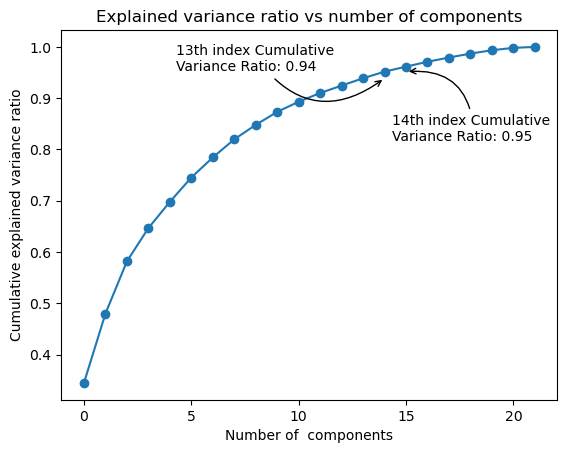

In [15]:
#Plot cumulative explained variance ratio
plt.plot(cumulative_variance_ratio,marker='o')
plt.xlabel('Number of  components')
plt.ylabel('Cumulative explained variance ratio')
plt.title('Explained variance ratio vs number of components')

#Find index with cumulativr variance ratio is 95% or less
index_95 = None
for i, ratio in enumerate(cumulative_variance_ratio):
    if ratio <= 0.95:
        index_95 = i
    else:
        break
print (index_95)

#Annotate at the index found above
annotate_index = index_95
plt.annotate(f'{annotate_index}th index Cumulative \nVariance Ratio: {cumulative_variance_ratio[annotate_index]:.2f}', 
             (annotate_index + 1, cumulative_variance_ratio[annotate_index]), 
             xytext=(-150, 5), 
             textcoords='offset points', 
             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5'))

annotate_index2 = annotate_index +1
plt.annotate(f'{annotate_index2}th index Cumulative \nVariance Ratio: {cumulative_variance_ratio[annotate_index2]:.2f}', 
             (annotate_index2 + 1, cumulative_variance_ratio[annotate_index2]), 
             xytext=(-10, -50), 
             textcoords='offset points', 
             arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5'))

plt.show()

# PERFORM FINAL PCA

In [16]:
#Perform PCA with for optimal number of components
pca = PCA(n_components=annotate_index2) #Use optimal number of components
pca.fit(X)

#Get explained variance ratio and components
explained_variance_ratio = pca.explained_variance_ratio_
components = pca.components_

#Sort components based on their importance (explained variance ratio from largest to smallest)
sorted_indices = explained_variance_ratio.argsort()[::-1]
selected_component_indices = sorted_indices[:annotate_index2] 

#Get the names of the original features for the selected components
original_column_names = X.columns
selected_component_names = [original_column_names[i] for i in selected_component_indices]

In [17]:
#Get the names of the original features for the selected components
original_column_names = X.columns
selected_component_names = [original_column_names[i] for i in selected_component_indices]
#print(selected_component_names)

#Create dataframe for optimal number of principal components
df_pca=X[selected_component_names].copy()

#Include target vaiable 
df_pca['Digital/Technological skills'] = y

df_pca.head()

,Foreign highly skilled personnel,Total expenditure on R&D (%),Scientific research legislation,Mobile broadband subscribers,EParticipation,Use of big data and analytics,Total public exp. on education per student,Health infrastructure,Skilled labor,Gross Domestic Product (GDP),GDP (PPP) per capita,Exports of goods growth,Government budget surplus/deficit (%),Tax evasion,Digital/Technological skills
0,0.524565,-0.561194,1.083241,1.023039,0.713693,1.130545,2.309253,0.738516,-0.013831,0.082300,0.390093,1.715123,-0.836902,1.102487,0.708586
1,0.354150,-0.541294,0.672756,1.443617,0.921162,0.866252,2.472463,0.261484,0.631120,0.136074,0.745904,0.008031,-0.303620,0.183795,0.238094
2,0.148233,-0.541294,0.561211,1.245545,0.190871,0.933731,3.048471,0.308834,0.735355,0.214946,0.589874,-0.227806,-0.482678,-0.823681,-0.076660
3,-0.514489,-0.551244,0.070413,1.245545,0.190871,-0.069081,3.048471,-0.333569,-1.140867,0.238140,1.096699,-1.107370,-0.521604,-1.202186,-0.709447
4,-0.563009,-0.511443,0.087145,1.245545,0.049793,0.084621,2.777281,-1.098940,0.526886,0.179376,0.964937,-0.143878,-0.397042,-1.118074,-0.114365


In [18]:
#Export DataFrame to CSV
df_pca.to_csv('DIGITAL COMPETITIVENESS-PCA.csv', index=False)

In [19]:
df_pca.columns

Index(['Foreign highly skilled personnel ', 'Total expenditure on R&D (%) ',
       'Scientific research legislation ', 'Mobile broadband subscribers ',
       'EParticipation ', 'Use of big data and analytics ',
       'Total public exp. on education per student ', 'Health infrastructure ',
       'Skilled labor ', 'Gross Domestic Product (GDP) ',
       'GDP (PPP) per capita ', 'Exports of goods  growth ',
       'Government budget surplus/deficit (%) ', 'Tax evasion ',
       'Digital/Technological skills'],
      dtype='object')